# WeatherPy
----

#### Note
* Instructions have been included for each segment. You do not have to follow them exactly, but they are included to help you think through the steps.

In [2]:
# Dependencies and Setup
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import requests
import time
from scipy.stats import linregress

# Import API key
from api_keys import weather_api

# Incorporated citipy to determine city based on latitude and longitude
from citipy import citipy

# Output File (CSV)
output_data_file = "output_data/cities.csv"

# Range of latitudes and longitudes
lat_range = (-90, 90)
lng_range = (-180, 180)

## Generate Cities List

In [3]:
# List for holding lat_lngs and cities
lat_lngs = []
cities = []

# Create a set of random lat and lng combinations
lats = np.random.uniform(lat_range[0], lat_range[1], size=1500)
lngs = np.random.uniform(lng_range[0], lng_range[1], size=1500)
lat_lngs = zip(lats, lngs)

# Identify nearest city for each lat, lng combination
for lat_lng in lat_lngs:
    city = citipy.nearest_city(lat_lng[0], lat_lng[1]).city_name
    
    # If the city is unique, then add it to a our cities list
    if city not in cities:
        cities.append(city)

# Print the city count to confirm sufficient count
len(cities)

617

### Perform API Calls
* Perform a weather check on each city using a series of successive API calls.
* Include a print log of each city as it'sbeing processed (with the city number and city name).


In [8]:
# URL
url = "http://api.openweathermap.org/data/2.5/weather?"

# Build partial query URL
units = "imperial"
query_url = f"{url}appid={weather_api}&units={units}&q="

# Set up list to hold reponses
responses = []

# Loop through the list of cities and perform a request for data on each
for city in cities:
    response = requests.get(query_url + city).json()
    responses.append(response)
    print (responses)

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}]
[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

[{'coord': {'lon': 25.5701, 'lat': -33.918}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 48.49, 'feels_like': 46, 'temp_min': 48.09, 'temp_max': 48.49, 'pressure': 1029, 'humidity': 87}, 'visibility': 10000, 'wind': {'speed': 5.75, 'deg': 280}, 'clouds': {'all': 0}, 'dt': 1627617145, 'sys': {'type': 1, 'id': 1973, 'country': 'ZA', 'sunrise': 1627621901, 'sunset': 1627659386}, 'timezone': 7200, 'id': 964420, 'name': 'Port Elizabeth', 'cod': 200}, {'coord': {'lon': -54.3333, 'lat': -34.4833}, 'weather': [{'id': 800, 'main': 'Clear', 'description': 'clear sky', 'icon': '01n'}], 'base': 'stations', 'main': {'temp': 38.71, 'feels_like': 35.17, 'temp_min': 38.71, 'temp_max': 38.71, 'pressure': 1027, 'humidity': 84, 'sea_level': 1027, 'grnd_level': 1024}, 'visibility': 10000, 'wind': {'speed': 4.74, 'deg': 311, 'gust': 4.63}, 'clouds': {'all': 6}, 'dt': 1627617157, 'sys': {'country': 'UY', 'sunrise': 1627641133, 's

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [7]:
print(cities)

['port elizabeth', 'rocha', 'taolanaro', 'kruisfontein', 'rikitea', 'punta arenas', 'bambous virieux', 'east london', 'sentyabrskiy', 'kazalinsk', 'rundu', 'qaqortoq', 'tarauaca', 'leningradskiy', 'hamilton', 'ugoofaaru', 'mahadday weyne', 'ushuaia', 'vanimo', 'horsham', 'katsuura', 'tura', 'nyrob', 'pangody', 'jamestown', 'presidencia roque saenz pena', 'pangnirtung', 'muravlenko', 'iwanai', 'khatanga', 'port alfred', 'busselton', 'karangampel', 'maldonado', 'dikson', 'lata', 'hebi', 'bougouni', 'albany', 'ribeira grande', 'port augusta', 'kaitangata', 'tasiilaq', 'sinnamary', 'gat', 'chokurdakh', 'arlit', 'cherskiy', 'kerteh', 'mbekenyera', 'susehri', 'esperance', 'roma', 'georgetown', 'aflu', 'atlantic city', 'bethel', 'alyangula', 'coihaique', 'tiksi', 'kahului', 'longonjo', 'mandalgovi', 'dombarovskiy', 'qingdao', 'comodoro rivadavia', 'arraial do cabo', 'hermanus', 'flin flon', 'qaanaaq', 'merauke', 'nanortalik', 'abbeville', 'camapua', 'atuona', 'saint-philippe', 'cap malheureux

Beginning Data Retrieval     
-----------------------------
Processing Record 1 of Set 1 | butaritari
Processing Record 2 of Set 1 | yerbogachen
Processing Record 3 of Set 1 | cape town
Processing Record 4 of Set 1 | touba
Processing Record 5 of Set 1 | jamestown
Processing Record 6 of Set 1 | rio grande
Processing Record 7 of Set 1 | ibra
Processing Record 8 of Set 1 | port elizabeth
Processing Record 9 of Set 1 | tuktoyaktuk
Processing Record 10 of Set 1 | avarua
Processing Record 11 of Set 1 | nemuro
Processing Record 12 of Set 1 | morgan city
Processing Record 13 of Set 1 | hobart
Processing Record 14 of Set 1 | kawalu
Processing Record 15 of Set 1 | hami
Processing Record 16 of Set 1 | ushuaia
Processing Record 17 of Set 1 | katsuura
Processing Record 18 of Set 1 | hjallerup
Processing Record 19 of Set 1 | punta arenas
Processing Record 20 of Set 1 | bengkulu
Processing Record 21 of Set 1 | victoria
Processing Record 22 of Set 1 | rangapara
Processing Record 23 of Set 1 | hithadho

### Convert Raw Data to DataFrame
* Export the city data into a .csv.
* Display the DataFrame

In [11]:
# Dump responses into a DataFrame
raw_df = pd.json_normalize(responses)
raw_df.head(5)

,weather,base,visibility,dt,timezone,id,name,cod,coord.lon,coord.lat,...,sys.id,sys.country,sys.sunrise,sys.sunset,main.sea_level,main.grnd_level,wind.gust,message,snow.1h,rain.1h
0,"[{'id': 800, 'main': 'Clear', 'description': '...",stations,10000.0,1.627617e+09,7200.0,964420.0,Port Elizabeth,200,25.5701,-33.9180,...,1973.0,ZA,1.627622e+09,1.627659e+09,NaN,NaN,NaN,NaN,NaN,NaN
1,"[{'id': 800, 'main': 'Clear', 'description': '...",stations,10000.0,1.627617e+09,-10800.0,3440777.0,Rocha,200,-54.3333,-34.4833,...,NaN,UY,1.627641e+09,1.627679e+09,1027.0,1024.0,4.63,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,404,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,city not found,NaN,NaN
3,"[{'id': 801, 'main': 'Clouds', 'description': ...",stations,10000.0,1.627617e+09,7200.0,986717.0,Kruisfontein,200,24.7314,-34.0033,...,2035063.0,ZA,1.627622e+09,1.627660e+09,1030.0,1002.0,5.46,NaN,NaN,NaN
4,"[{'id': 800, 'main': 'Clear', 'description': '...",stations,10000.0,1.627617e+09,-32400.0,4030556.0,Rikitea,200,-134.9692,-23.1203,...,NaN,PF,1.627573e+09,1.627613e+09,1015.0,1012.0,5.77,NaN,NaN,NaN


In [15]:
# Select columns
df_1 = raw_df[['name', 'coord.lat', 'coord.lon','main.temp_max' ,'main.humidity','clouds.all','wind.speed','sys.country','dt']]
df_1.columns = ['City', 'Lat', 'Lng', 'Max Temp','Humidity','Cloudiness','Wind Speed','Country','Date']
df_2 = df_1.dropna()
df_2

,City,Lat,Lng,Max Temp,Humidity,Cloudiness,Wind Speed,Country,Date
0,Port Elizabeth,-33.9180,25.5701,48.49,87.0,0.0,5.75,ZA,1.627617e+09
1,Rocha,-34.4833,-54.3333,38.71,84.0,6.0,4.74,UY,1.627617e+09
3,Kruisfontein,-34.0033,24.7314,45.88,78.0,12.0,5.64,ZA,1.627617e+09
4,Rikitea,-23.1203,-134.9692,71.56,76.0,1.0,6.04,PF,1.627617e+09
5,Punta Arenas,-53.1500,-70.9167,37.51,81.0,75.0,21.85,CL,1.627617e+09
...,...,...,...,...,...,...,...,...,...
612,Yar-Sale,66.8333,70.8333,52.21,84.0,92.0,18.88,RU,1.627617e+09
613,Zalesovo,53.9939,84.7431,67.42,52.0,85.0,5.37,RU,1.627617e+09
614,Shimoda,34.6667,138.9500,86.36,72.0,53.0,4.09,JP,1.627617e+09
615,Auki,-8.7676,160.7034,85.73,64.0,6.0,2.89,SB,1.627617e+09


,City,Lat,Lng,Max Temp,Humidity,Cloudiness,Wind Speed,Country,Date
0,butaritari,3.07,172.79,83.32,74,84,10.42,KI,1593605283
1,yerbogachen,61.28,108.01,79.52,58,20,7.70,RU,1593605121
2,cape town,-33.93,18.42,73.00,77,27,4.70,ZA,1593605039
3,touba,8.28,-7.68,79.97,75,82,3.58,CI,1593605284
4,jamestown,42.10,-79.24,64.00,88,1,6.93,US,1593605284


In [16]:
df_2.describe()

,Lat,Lng,Max Temp,Humidity,Cloudiness,Wind Speed,Date
count,559.000000,559.000000,559.000000,559.000000,559.000000,559.000000,5.590000e+02
mean,19.578139,22.038664,68.642630,70.504472,50.216458,7.612272,1.627617e+09
std,33.804006,89.334561,14.286865,19.768541,39.294924,5.834578,4.837038e+01
min,-54.800000,-179.166700,32.070000,11.000000,0.000000,0.000000,1.627617e+09
25%,-8.617500,-58.693500,59.010000,58.000000,6.000000,3.440000,1.627617e+09
50%,22.285500,27.346500,70.410000,75.000000,48.000000,5.990000,1.627617e+09
75%,48.453700,101.767600,79.905000,86.000000,90.000000,10.070000,1.627617e+09
max,78.218600,179.316700,99.250000,100.000000,100.000000,37.290000,1.627617e+09


,Lat,Lng,Max Temp,Humidity,Cloudiness,Wind Speed,Date
count,599.000000,599.000000,599.000000,599.000000,599.000000,599.000000,5.990000e+02
mean,19.877028,19.568998,69.794808,69.353923,51.569282,7.979416,1.593605e+09
std,33.262944,91.418472,15.678452,22.704698,35.405602,5.660694,5.738815e+01
min,-54.800000,-179.170000,12.200000,7.000000,0.000000,0.360000,1.593605e+09
25%,-8.540000,-61.210000,59.000000,55.000000,20.000000,3.620000,1.593605e+09
50%,24.370000,24.670000,73.110000,75.000000,59.000000,6.730000,1.593605e+09
75%,46.585000,102.255000,80.600000,87.000000,85.000000,11.050000,1.593605e+09
max,78.220000,179.320000,116.600000,100.000000,100.000000,42.500000,1.593605e+09


## Inspect the data and remove the cities where the humidity > 100%.
----
Skip this step if there are no cities that have humidity > 100%. 

In [ ]:
# There is no cities that have humidity > 100%.

,Lat,Lng,Max Temp,Humidity,Cloudiness,Wind Speed,Date
count,550.000000,550.000000,550.000000,550.000000,550.000000,550.000000,5.500000e+02
mean,19.973545,17.124400,58.331400,67.890909,52.141818,8.544800,1.585764e+09
std,33.284840,91.595451,25.795297,20.864881,35.766469,6.078869,5.539674e+01
min,-54.800000,-179.170000,-11.340000,9.000000,0.000000,0.160000,1.585764e+09
25%,-8.077500,-64.627500,42.800000,55.000000,20.000000,4.525000,1.585764e+09
50%,23.630000,19.635000,64.940000,72.000000,57.000000,7.325000,1.585764e+09
75%,48.672500,97.350000,78.800000,83.000000,86.750000,11.410000,1.585764e+09
max,78.220000,179.320000,102.200000,100.000000,100.000000,46.080000,1.585764e+09


In [ ]:
# Make a new DataFrame equal to the city data to drop all humidity outliers by index.
# Passing "inplace=False" will make a copy of the city_data DataFrame, which we call "clean_city_data".

In [18]:
clean_city_data = df_2
clean_city_data.head(5)

,City,Lat,Lng,Max Temp,Humidity,Cloudiness,Wind Speed,Country,Date
0,Port Elizabeth,-33.9180,25.5701,48.49,87.0,0.0,5.75,ZA,1.627617e+09
1,Rocha,-34.4833,-54.3333,38.71,84.0,6.0,4.74,UY,1.627617e+09
3,Kruisfontein,-34.0033,24.7314,45.88,78.0,12.0,5.64,ZA,1.627617e+09
4,Rikitea,-23.1203,-134.9692,71.56,76.0,1.0,6.04,PF,1.627617e+09
5,Punta Arenas,-53.1500,-70.9167,37.51,81.0,75.0,21.85,CL,1.627617e+09


,City,Lat,Lng,Max Temp,Humidity,Cloudiness,Wind Speed,Country,Date
0,butaritari,3.07,172.79,83.32,74,84,10.42,KI,1593605283
1,yerbogachen,61.28,108.01,79.52,58,20,7.70,RU,1593605121
2,cape town,-33.93,18.42,73.00,77,27,4.70,ZA,1593605039
3,touba,8.28,-7.68,79.97,75,82,3.58,CI,1593605284
4,jamestown,42.10,-79.24,64.00,88,1,6.93,US,1593605284


In [ ]:
# TODO Export clean_city_data to csv



## Plotting the Data
* Use proper labeling of the plots using plot titles (including date of analysis) and axes labels.
* Save the plotted figures as .pngs.

In [123]:
# Select columns
scatter_df = clean_city_data[['Lat', 'Max Temp', 'Humidity','Cloudiness' ,'Wind Speed','Date']]
scatter_df.columns = ["Lattitude", "Max Temperature (F)", "Humidity (%)", "Cloudiness (%)", "Wind Speed (mph)",'Date']
scatter_df

,Lattitude,Max Temperature (F),Humidity (%),Cloudiness (%),Wind Speed (mph),Date
0,-33.9180,48.49,87.0,0.0,5.75,1.627617e+09
1,-34.4833,38.71,84.0,6.0,4.74,1.627617e+09
3,-34.0033,45.88,78.0,12.0,5.64,1.627617e+09
4,-23.1203,71.56,76.0,1.0,6.04,1.627617e+09
5,-53.1500,37.51,81.0,75.0,21.85,1.627617e+09
...,...,...,...,...,...,...
612,66.8333,52.21,84.0,92.0,18.88,1.627617e+09
613,53.9939,67.42,52.0,85.0,5.37,1.627617e+09
614,34.6667,86.36,72.0,53.0,4.09,1.627617e+09
615,-8.7676,85.73,64.0,6.0,2.89,1.627617e+09


In [137]:
Date = scatter_df['Date'].max()
Date

1627617211.0

In [138]:
print(Date)

1627617211.0


## Latitude vs. Temperature Plot

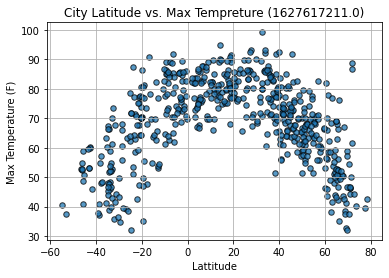

In [139]:
# Create a scatter plot which compares Max Temperature (F) vs. Latitude
scatter_df.plot(kind="scatter", x="Lattitude", y="Max Temperature (F)",marker="o", facecolors="blue",
edgecolors="black", s=30,alpha=0.75,figsize=(6,4), title=f"City Latitude vs. Max Tempreture ({Date})")
plt.grid(True)
plt.savefig("../Images/Latitude_vs._Temperature Plot.png", bbox_inches = "tight")

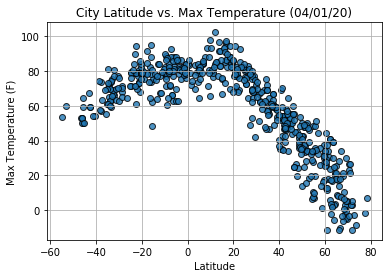

## Latitude vs. Humidity Plot

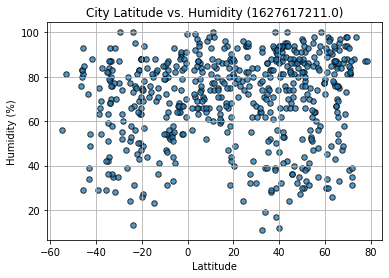

In [140]:
# Create a scatter plot which Humidity (%) vs. Latitude
scatter_df.plot(kind="scatter", x="Lattitude", y="Humidity (%)",marker="o", facecolors="blue",
edgecolors="black", s=30,alpha=0.75, 
figsize=(6,4), title=f"City Latitude vs. Humidity ({Date})")
plt.grid(True)
plt.savefig("../Images/Latitude_vs._Humidity_Plot.png", bbox_inches = "tight")

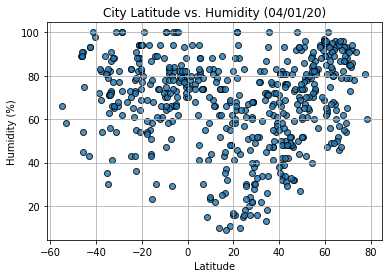

## Latitude vs. Cloudiness Plot

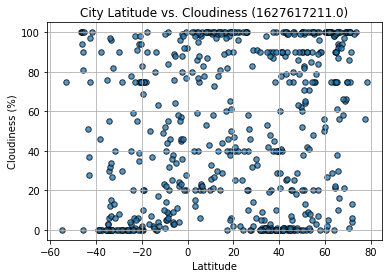

In [141]:
# Create a scatter plot which Cloudiness (%) vs. Latitude
scatter_df.plot(kind="scatter", x="Lattitude", y="Cloudiness (%)",marker="o", facecolors="blue",
edgecolors="black", s=30,alpha=0.75, 
figsize=(6,4), title=f"City Latitude vs. Cloudiness ({Date})")
plt.grid(True)
plt.savefig("../Images/Latitude_vs._Cloudiness_Plot.png", bbox_inches = "tight")

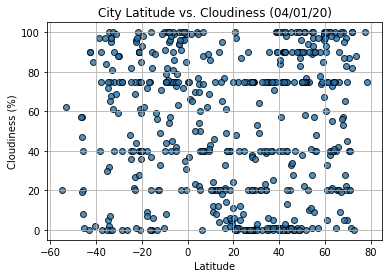

## Latitude vs. Wind Speed Plot

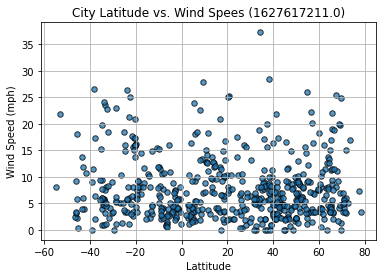

In [142]:
# Create a scatter plot which compares Wind Speed (mph) vs. Latitude
scatter_df.plot(kind="scatter", x="Lattitude", y="Wind Speed (mph)",marker="o", facecolors="blue",
edgecolors="black",alpha=0.75, s=30, 
figsize=(6,4), title=f"City Latitude vs. Wind Spees ({Date})")
plt.grid(True)
plt.savefig("../Images/Latitude_vs._Wind_Speed_Plot.png", bbox_inches = "tight")

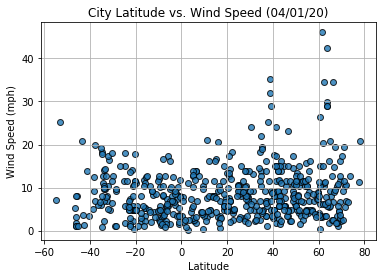

## Linear Regression

In [66]:
# Select columns & prepare the complete dataframe
regression_df = scatter_df
regression_df

,Lattitude,Max Temperature (F),Humidity (%),Cloudiness (%),Wind Speed (mph)
0,-33.9180,48.49,87.0,0.0,5.75
1,-34.4833,38.71,84.0,6.0,4.74
3,-34.0033,45.88,78.0,12.0,5.64
4,-23.1203,71.56,76.0,1.0,6.04
5,-53.1500,37.51,81.0,75.0,21.85
...,...,...,...,...,...
612,66.8333,52.21,84.0,92.0,18.88
613,53.9939,67.42,52.0,85.0,5.37
614,34.6667,86.36,72.0,53.0,4.09
615,-8.7676,85.73,64.0,6.0,2.89


In [67]:
# prepare the dataframe for Northern Hemishpere
regression_nh_df = regression_df.loc[regression_df["Lattitude"] >=0]
regression_nh_df

,Lattitude,Max Temperature (F),Humidity (%),Cloudiness (%),Wind Speed (mph)
11,60.7167,43.52,89.0,100.0,4.14
13,69.3833,32.74,98.0,100.0,19.80
14,39.1834,79.00,88.0,29.0,1.01
15,5.6667,82.54,74.0,22.0,9.15
19,51.0640,61.02,78.0,75.0,6.91
...,...,...,...,...,...
610,45.1667,73.71,86.0,7.0,1.83
612,66.8333,52.21,84.0,92.0,18.88
613,53.9939,67.42,52.0,85.0,5.37
614,34.6667,86.36,72.0,53.0,4.09


In [102]:
# prepare the dataframe for Southern Hemishpere
regression_sh_df = regression_df.loc[regression_df["Lattitude"] <=0]
regression_sh_df

,Lattitude,Max Temperature (F),Humidity (%),Cloudiness (%),Wind Speed (mph)
0,-33.9180,48.49,87.0,0.0,5.75
1,-34.4833,38.71,84.0,6.0,4.74
3,-34.0033,45.88,78.0,12.0,5.64
4,-23.1203,71.56,76.0,1.0,6.04
5,-53.1500,37.51,81.0,75.0,21.85
...,...,...,...,...,...
603,-8.1900,84.06,56.0,32.0,2.26
606,-31.5889,41.56,93.0,6.0,2.30
608,-4.8769,71.76,64.0,11.0,5.01
611,-43.5333,59.47,72.0,51.0,4.00


####  Northern Hemisphere - Max Temp vs. Latitude Linear Regression

The r-value is: -0.7027541409202375


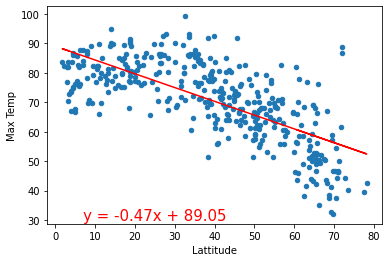

In [103]:
# Calculate the correlation coefficient and linear regression model 
# for Max Temp vs. Latitude Linear Regression in the Northern Hemisphere

# Plot out Max temp versus Lattitude
regression_nh_df.plot(kind="scatter", x="Lattitude", y="Max Temperature (F)")
plt.xlabel('Lattitude')
plt.ylabel('Max Temp')

# Define scatter values for x and y axis
x_values = regression_nh_df['Lattitude']
y_values = regression_nh_df['Max Temperature (F)']

# Compute regression line
slope, intercept, rvalue, pvalue, stderr = linregress(x_values, y_values)

# Get y_axis values for the the regression line and add to plot
regress_values = x_values * slope + intercept


plt.plot(x_values,regress_values,"r-")

# Get string with the equation formula and add to plot
line_eq = "y = " + str(round(slope,2)) + "x + " + str(round(intercept,2))
plt.annotate(line_eq,(7,30),fontsize=15,color="red")
plt.savefig("../Images/Northern Hemisphere_Max Temp_vs._Latitude_Linear_Regression.png", bbox_inches = "tight")
print(f"The r-value is: {rvalue}")
plt.show()

The r-value is: 0.46937863826630627


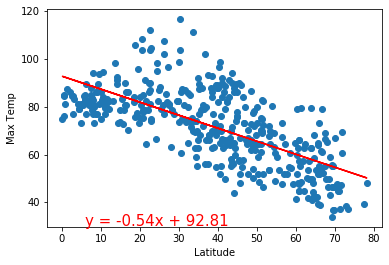

####  Southern Hemisphere - Max Temp vs. Latitude Linear Regression

The r-value is: 0.696423165442831


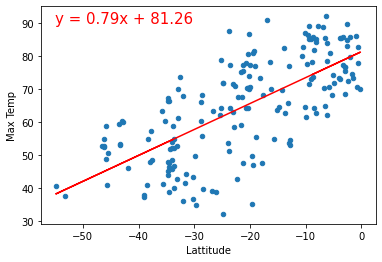

In [104]:
# Calculate the correlation coefficient and linear regression model 
# for Max Temp vs. Latitude Linear Regression in the Southern Hemisphere

# Plot out Max temp versus Lattitude
regression_sh_df.plot(kind="scatter", x="Lattitude", y="Max Temperature (F)")
plt.xlabel('Lattitude')
plt.ylabel('Max Temp')

# Define scatter values for x and y axis
x_values = regression_sh_df['Lattitude']
y_values = regression_sh_df['Max Temperature (F)']

# Compute regression line
slope, intercept, rvalue, pvalue, stderr = linregress(x_values, y_values)

# Get y_axis values for the the regression line and add to plot
regress_values = x_values * slope + intercept


plt.plot(x_values,regress_values,"r-")

# Get string with the equation formula and add to plot
line_eq = "y = " + str(round(slope,2)) + "x + " + str(round(intercept,2))
plt.annotate(line_eq,(-55,90),fontsize=15,color="red")
plt.savefig("../Images/Southern_Hemisphere_Max Temp_vs._Latitude_Linear_Regression.png", bbox_inches = "tight")
print(f"The r-value is: {rvalue}")
plt.show()

The r-value is: 0.6082708688906918


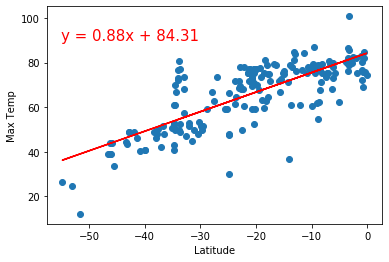

####  Northern Hemisphere - Humidity (%) vs. Latitude Linear Regression

The r-value is: -0.03696604664237331


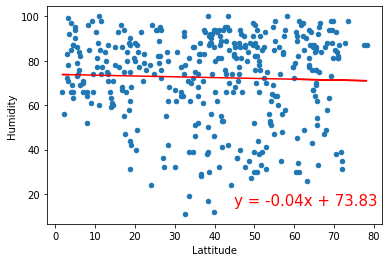

In [111]:
# Calculate the correlation coefficient and linear regression model 
# for Humidity vs. Latitude Linear Regression in the Northern Hemisphere
regression_nh_df.plot(kind="scatter", x="Lattitude", y="Humidity (%)")
plt.xlabel('Lattitude')
plt.ylabel('Humidity')
x_values = regression_nh_df['Lattitude']
y_values = regression_nh_df['Humidity (%)']
slope, intercept, rvalue, pvalue, stderr = linregress(x_values, y_values)
regress_values = x_values * slope + intercept
plt.plot(x_values,regress_values,"r-")
line_eq = "y = " + str(round(slope,2)) + "x + " + str(round(intercept,2))
plt.annotate(line_eq,(45,15),fontsize=15,color="red")
plt.savefig("../Images/Northern_Hemisphere_Humidity_(%)_vs._Latitude_Linear_Regression.png", bbox_inches = "tight")
print(f"The r-value is: {rvalue}")
plt.show()

The r-value is: 0.000543987878808455


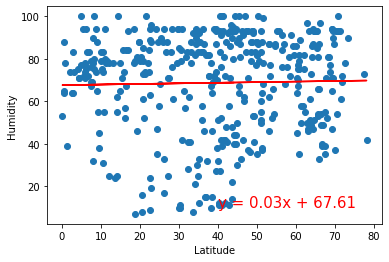

####  Southern Hemisphere - Humidity (%) vs. Latitude Linear Regression

The r-value is: 0.0822444084744681


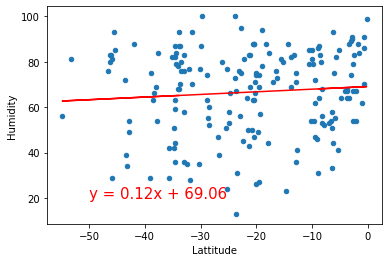

In [112]:
# Calculate the correlation coefficient and linear regression model 
# for Humidity vs. Latitude Linear Regression in the Southern Hemisphere
regression_sh_df.plot(kind="scatter", x="Lattitude", y="Humidity (%)")
plt.xlabel('Lattitude')
plt.ylabel('Humidity')
x_values = regression_sh_df['Lattitude']
y_values = regression_sh_df['Humidity (%)']
slope, intercept, rvalue, pvalue, stderr = linregress(x_values, y_values)
regress_values = x_values * slope + intercept
plt.plot(x_values,regress_values,"r-")
line_eq = "y = " + str(round(slope,2)) + "x + " + str(round(intercept,2))
plt.annotate(line_eq,(-50,20),fontsize=15,color="red")
plt.savefig("../Images/Southern_Hemisphere_Humidity_(%)_vs._Latitude_Linear_Regression.png", bbox_inches = "tight")
print(f"The r-value is: {rvalue}")
plt.show()

The r-value is: 0.014985174297345524


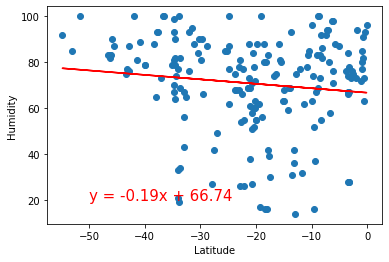

####  Northern Hemisphere - Cloudiness (%) vs. Latitude Linear Regression

The r-value is: 0.0395718400829981


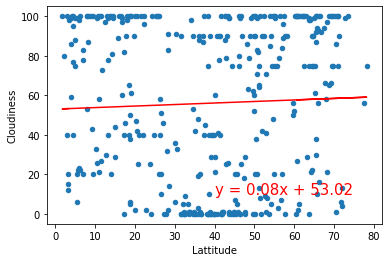

In [113]:
# Calculate the correlation coefficient and linear regression model 
# for Cloudiness (%) vs. Latitude Linear Regression in the Northern Hemisphere
regression_nh_df.plot(kind="scatter", x="Lattitude", y="Cloudiness (%)")
plt.xlabel('Lattitude')
plt.ylabel('Cloudiness')
x_values = regression_nh_df['Lattitude']
y_values = regression_nh_df['Cloudiness (%)']
slope, intercept, rvalue, pvalue, stderr = linregress(x_values, y_values)
regress_values = x_values * slope + intercept
plt.plot(x_values,regress_values,"r-")
line_eq = "y = " + str(round(slope,2)) + "x + " + str(round(intercept,2))
plt.annotate(line_eq,(40,10),fontsize=15,color="red")
plt.savefig("../Images/Northern_Hemisphere_Cloudiness_(%)_vs._Latitude_Linear_Regression.png", bbox_inches = "tight")
print(f"The r-value is: {rvalue}")
plt.show()

The r-value is: 0.0020898727664228514


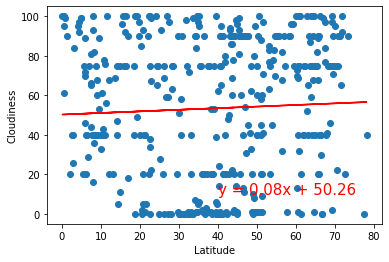

####  Southern Hemisphere - Cloudiness (%) vs. Latitude Linear Regression

The r-value is: 0.06823695294465677


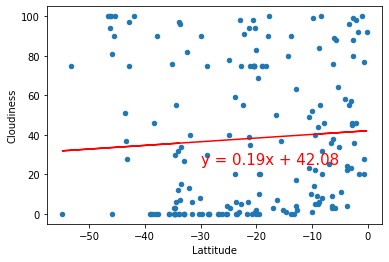

In [108]:
# Calculate the correlation coefficient and linear regression model 
# for Cloudiness (%) vs. Latitude Linear Regression in the Southern Hemisphere
regression_sh_df.plot(kind="scatter", x="Lattitude", y="Cloudiness (%)")
plt.xlabel('Lattitude')
plt.ylabel('Cloudiness')
x_values = regression_sh_df['Lattitude']
y_values = regression_sh_df['Cloudiness (%)']
slope, intercept, rvalue, pvalue, stderr = linregress(x_values, y_values)
regress_values = x_values * slope + intercept
plt.plot(x_values,regress_values,"r-")
line_eq = "y = " + str(round(slope,2)) + "x + " + str(round(intercept,2))
plt.annotate(line_eq,(-30,25),fontsize=15,color="red")
plt.savefig("../Images/Southern_Hemisphere_Cloudiness_(%)_vs._Latitude_Linear_Regression.png", bbox_inches = "tight")
print(f"The r-value is: {rvalue}")
plt.show()

The r-value is: 0.0035263772085582894


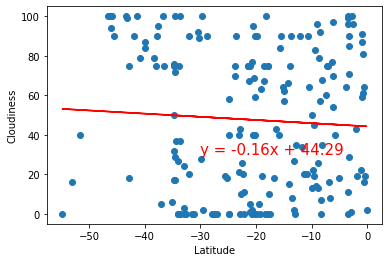

####  Northern Hemisphere - Wind Speed (mph) vs. Latitude Linear Regression

The r-value is: -0.013332662614148644


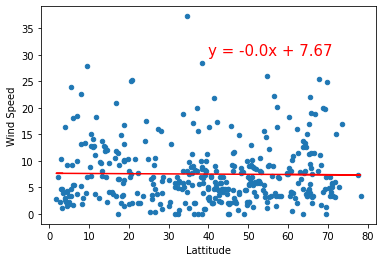

In [109]:
# Calculate the correlation coefficient and linear regression model 
# for Wind Speed (mph) vs. Latitude Linear Regression in the Northern Hemisphere
regression_nh_df.plot(kind="scatter", x="Lattitude", y="Wind Speed (mph)")
plt.xlabel('Lattitude')
plt.ylabel('Wind Speed')
x_values = regression_nh_df['Lattitude']
y_values = regression_nh_df['Wind Speed (mph)']
slope, intercept, rvalue, pvalue, stderr = linregress(x_values, y_values)
regress_values = x_values * slope + intercept
plt.plot(x_values,regress_values,"r-")
line_eq = "y = " + str(round(slope,2)) + "x + " + str(round(intercept,2))
plt.annotate(line_eq,(40,30),fontsize=15,color="red")
plt.savefig("../Images/Northern_Hemisphere_Cloudiness_(%)_vs._Latitude_Linear_Regression.png", bbox_inches = "tight")
print(f"The r-value is: {rvalue}")
plt.show()

The r-value is: 0.04019723576144484


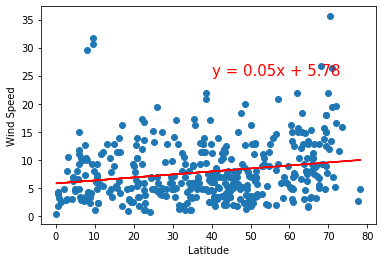

####  Southern Hemisphere - Wind Speed (mph) vs. Latitude Linear Regression

The r-value is: -0.1865172534433983


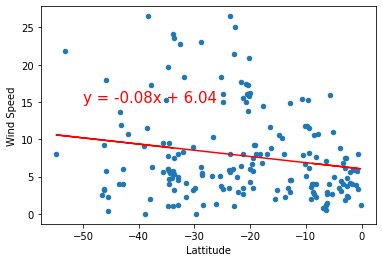

In [110]:
# Calculate the correlation coefficient and linear regression model 
# for Wind Speed (mph) vs. Latitude Linear Regression in the Southern Hemisphere
regression_sh_df.plot(kind="scatter", x="Lattitude", y="Wind Speed (mph)")
plt.xlabel('Lattitude')
plt.ylabel('Wind Speed')
x_values = regression_sh_df['Lattitude']
y_values = regression_sh_df['Wind Speed (mph)']
slope, intercept, rvalue, pvalue, stderr = linregress(x_values, y_values)
regress_values = x_values * slope + intercept
plt.plot(x_values,regress_values,"r-")
line_eq = "y = " + str(round(slope,2)) + "x + " + str(round(intercept,2))
plt.annotate(line_eq,(-50,15),fontsize=15,color="red")
plt.savefig("../Images/Southern_Hemisphere_Wind_Speed_(mph)_vs._Latitude_Linear_Regression.png", bbox_inches = "tight")
print(f"The r-value is: {rvalue}")
plt.show()

The r-value is: 0.017128274759839232


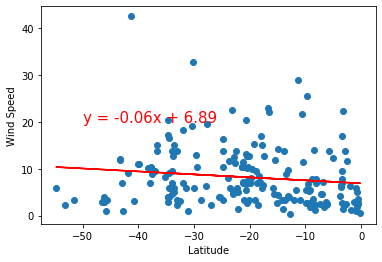